In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
import plotly.express as px
import warnings

warnings.simplefilter(action='ignore', category=FutureWarning)


In [2]:
df = pd.read_csv('IndianWeatherRepository.csv')

In [3]:
df.shape

(78297, 42)

In [4]:
df.head()

,country,location_name,region,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,India,Ashoknagar,Madhya Pradesh,24.57,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,12.6,18.5,1,2,05:59 AM,06:41 PM,05:42 PM,03:38 AM,Waxing Gibbous,93
1,India,Raisen,Madhya Pradesh,23.33,77.80,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,10.7,14.2,1,1,06:00 AM,06:40 PM,05:39 PM,03:41 AM,Waxing Gibbous,93
2,India,Chhindwara,Madhya Pradesh,22.07,78.93,Asia/Kolkata,1693286100,2023-08-29 10:45,26.3,79.3,...,16.8,20.7,2,2,05:56 AM,06:34 PM,05:32 PM,03:39 AM,Waxing Gibbous,93
3,India,Betul,Madhya Pradesh,21.86,77.93,Asia/Kolkata,1693286100,2023-08-29 10:45,25.6,78.1,...,4.9,6.6,1,1,06:00 AM,06:38 PM,05:36 PM,03:43 AM,Waxing Gibbous,93
4,India,Hoshangabad,Madhya Pradesh,22.75,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.2,81.0,...,11.4,14.8,1,1,06:01 AM,06:39 PM,05:38 PM,03:42 AM,Waxing Gibbous,93


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78297 entries, 0 to 78296
Data columns (total 42 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   country                       78297 non-null  object 
 1   location_name                 78297 non-null  object 
 2   region                        78297 non-null  object 
 3   latitude                      78297 non-null  float64
 4   longitude                     78297 non-null  float64
 5   timezone                      78297 non-null  object 
 6   last_updated_epoch            78297 non-null  int64  
 7   last_updated                  78297 non-null  object 
 8   temperature_celsius           78297 non-null  float64
 9   temperature_fahrenheit        78297 non-null  float64
 10  condition_text                78297 non-null  object 
 11  wind_mph                      78297 non-null  float64
 12  wind_kph                      78297 non-null  float64
 13  w

In [6]:
df.describe(include='all')

,country,location_name,region,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
count,78297,78297,78297,78297.000000,78297.000000,78297,7.829700e+04,78297,78297.000000,78297.000000,...,78297.000000,78297.000000,78297.000000,78297.000000,78297,78297,78297,78297,78297,78297.000000
unique,1,551,33,NaN,NaN,3,NaN,568,NaN,NaN,...,NaN,NaN,NaN,NaN,177,183,1441,1441,8,NaN
top,India,Udaipur,Uttar Pradesh,NaN,NaN,Asia/Kolkata,NaN,2024-01-19 23:45,NaN,NaN,...,NaN,NaN,NaN,NaN,06:07 AM,06:01 PM,No moonrise,No moonset,Waxing Crescent,NaN
freq,78297,279,8728,NaN,NaN,77868,NaN,546,NaN,NaN,...,NaN,NaN,NaN,NaN,1149,1038,2742,2739,16993,NaN
mean,NaN,NaN,NaN,23.096695,80.241279,NaN,1.699598e+09,NaN,19.963108,67.933817,...,100.513371,116.863328,3.353487,6.830798,NaN,NaN,NaN,NaN,NaN,49.836865
std,NaN,NaN,NaN,5.794389,5.758004,NaN,3.745547e+06,NaN,5.981350,10.766112,...,102.044373,114.529182,1.499657,3.613333,NaN,NaN,NaN,NaN,NaN,34.810037
min,NaN,NaN,NaN,7.170000,68.970000,NaN,1.693286e+09,NaN,-18.200000,-0.800000,...,0.500000,0.600000,1.000000,1.000000,NaN,NaN,NaN,NaN,NaN,0.000000
25%,NaN,NaN,NaN,20.270000,76.070000,NaN,1.696284e+09,NaN,16.600000,61.900000,...,28.600000,36.200000,2.000000,3.000000,NaN,NaN,NaN,NaN,NaN,15.000000
50%,NaN,NaN,NaN,23.950000,78.690000,NaN,1.699474e+09,NaN,21.000000,69.800000,...,69.200000,84.200000,4.000000,9.000000,NaN,NaN,NaN,NaN,NaN,49.000000
75%,NaN,NaN,NaN,26.770000,83.900000,NaN,1.702926e+09,NaN,24.200000,75.600000,...,135.900000,157.000000,4.000000,10.000000,NaN,NaN,NaN,NaN,NaN,85.000000


In [7]:
df['last_updated'] =  pd.to_datetime(df['last_updated'])

In [8]:
df['last_updated'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 78297 entries, 0 to 78296
Series name: last_updated
Non-Null Count  Dtype         
--------------  -----         
78297 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 611.8 KB


# EDA

## 1. Temperature
Analyzing the Temperature Parameter by plotting several Visualizaions

In [9]:
df['region'].unique()

array(['Madhya Pradesh', 'Uttar Pradesh', 'Orissa', 'Rajasthan',
       'Gujarat', 'Himachal Pradesh', 'Chhattisgarh', 'Jammu and Kashmir',
       'Daman and Diu', 'Dadra and Nagar Haveli', 'Andhra Pradesh',
       'Jharkhand', 'Bihar', 'West Bengal', 'Maharashtra', 'Haryana',
       'Chandigarh', 'Goa', 'Andaman and Nicobar Islands',
       'Arunachal Pradesh', 'Assam', 'Puducherry', 'Kerala', 'Mizoram',
       'Manipur', 'Nagaland', 'Tripura', 'Karnataka', 'Uttarakhand',
       'Lakshadweep', 'Punjab', 'Tamil Nadu', 'Delhi'], dtype=object)

In [10]:
print(df[df['region'] == 'Madhya Pradesh']['temperature_celsius'].min())
df[df['region'] == 'Madhya Pradesh']['temperature_celsius'].max()

2.0


32.4

In [11]:
unique_regions = df['region'].unique()

for region in unique_regions:
    region_data = df[df['region'] == region]
    
    min_temperature = region_data['temperature_celsius'].min()
    max_temperature = region_data['temperature_celsius'].max()
    
    print(f"Region: {region}, Min Temperature: {min_temperature}, Max Temperature: {max_temperature}")


Region: Madhya Pradesh, Min Temperature: 2.0, Max Temperature: 32.4
Region: Uttar Pradesh, Min Temperature: 5.0, Max Temperature: 33.0
Region: Orissa, Min Temperature: 10.7, Max Temperature: 34.6
Region: Rajasthan, Min Temperature: 6.0, Max Temperature: 38.3
Region: Gujarat, Min Temperature: 14.1, Max Temperature: 32.4
Region: Himachal Pradesh, Min Temperature: 1.2, Max Temperature: 25.5
Region: Chhattisgarh, Min Temperature: 8.9, Max Temperature: 30.9
Region: Jammu and Kashmir, Min Temperature: -18.2, Max Temperature: 31.0
Region: Daman and Diu, Min Temperature: 18.4, Max Temperature: 28.6
Region: Dadra and Nagar Haveli, Min Temperature: 19.2, Max Temperature: 28.3
Region: Andhra Pradesh, Min Temperature: 14.5, Max Temperature: 35.3
Region: Jharkhand, Min Temperature: 7.0, Max Temperature: 34.0
Region: Bihar, Min Temperature: 7.0, Max Temperature: 34.0
Region: West Bengal, Min Temperature: 7.7, Max Temperature: 34.2
Region: Maharashtra, Min Temperature: 13.1, Max Temperature: 31.0
Reg

### Mapping the Regions by labelling its min and max tempetature °C

In [12]:
# Create a map centered around the first location in the DataFrame
map_center = [df['latitude'].iloc[0], df['longitude'].iloc[0]]
mymap = folium.Map(location=map_center, zoom_start=6)

# Iterate through unique regions
for region in unique_regions:
    region_data = df[df['region'] == region]
    
    # Calculate average latitude and longitude for the region
    avg_latitude = region_data['latitude'].mean()
    avg_longitude = region_data['longitude'].mean()
    
    # Get min and max temperatures for the region
    min_temperature = region_data['temperature_celsius'].min()
    max_temperature = region_data['temperature_celsius'].max()
    
    # Create a popup with region and temperature information
    popup_text = f"Region: {region}<br>Min Temperature: {min_temperature} °C <br>Max Temperature: {max_temperature} °C"
    
    # Customize the marker icon and text
    marker_icon = folium.Icon(color='blue', icon='info-sign')
    marker = folium.Marker(location=[avg_latitude, avg_longitude], icon=marker_icon,tooltip=f"{region} - Min: {min_temperature} °C, Max: {max_temperature} °C")
    
    # Customize the font style and color of the text inside the marker
    marker.add_child(folium.Popup(popup_text, parse_html=False, max_width=300))
    marker.add_to(mymap)

# Display the map directly in the output cell
mymap


### Average Temperature by Region

In [13]:
fig = px.bar(df.groupby('region')['temperature_celsius'].mean().reset_index(),
             x='region',
             y='temperature_celsius',
             title='Average Temperature by Region',
             labels={'temperature_celsius': 'Average Temperature (°C)', 'region': 'Region'})

fig.update_layout(xaxis=dict(tickangle=45))
fig.show()


### Temperature Variations of each region Over time

In [14]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

regions = df['region'].unique()

# Create subplots for each region
fig = make_subplots(rows=len(regions), cols=1, subplot_titles=[f'Temperature Variations Over Time - {region}' for region in regions])

# Loop through each region and add a line trace for wind speed against last_updated
for i, region in enumerate(regions):
    region_data = df[df['region'] == region]
    fig.add_trace(go.Scatter(x=region_data['last_updated'], y=region_data['temperature_celsius'],
                             mode='lines', name=region,showlegend=False, line=dict(width=2)),
                  row=i+1, col=1)

# Update layout
fig.update_layout(height=600 * len(regions), width=1000, showlegend=True, xaxis=dict(title='Time'),
                  yaxis=dict(title='Temperature (°C)'))

### Plotting a Heatmap for all Parameters

In [15]:
heatmap_columns = [
    'temperature_celsius', 'wind_mph', 'wind_kph',
    'wind_degree', 'pressure_mb', 'pressure_in',
    'precip_mm', 'precip_in', 'humidity', 'cloud', 'visibility_km', 'visibility_miles',
    'uv_index', 'gust_mph', 'gust_kph', 'air_quality_Carbon_Monoxide',
    'air_quality_Ozone', 'air_quality_Nitrogen_dioxide',
    'air_quality_Sulphur_dioxide', 'air_quality_us-epa-index', 'air_quality_gb-defra-index'
]

# Select relevant columns for the heatmap
heatmap_data = df[heatmap_columns]

# Create a heatmap
fig = px.imshow(heatmap_data.corr(), x=heatmap_columns, y=heatmap_columns, color_continuous_scale='Viridis',
                labels=dict(color='Correlation'), title='Heatmap of Correlation Matrix')
fig.update_layout(height=800, width=1200) 

fig.show()

## Scatter Plots:Temperature vs. Various Parameters Analysis

### Temprerature vs Pressure

We can infer from the Heatmap, temperature is highly correlated with pressure. Lets plot scatter plots across each region for better visualization.

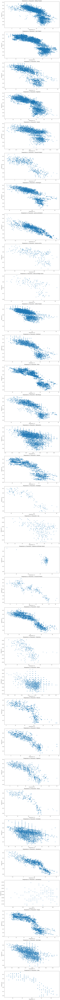

In [16]:
regions = df['region'].unique()

# Create subplots for each region
fig, axes = plt.subplots(nrows=len(regions), figsize=(12, 6 * len(regions)))

for i, region in enumerate(regions):
    region_data = df[df['region'] == region]
    
    # Create scatter plot for temperature against humidity for each region
    axes[i].scatter(region_data['temperature_celsius'], region_data['pressure_in'], alpha=0.5)
    
    axes[i].set_title(f'Temperature vs. Pressure(in) - {region}')
    axes[i].set_xlabel('Temperature (°C)')
    axes[i].set_ylabel('Pressure (in)')

plt.tight_layout()
plt.show()

### Temprerature vs Humidity

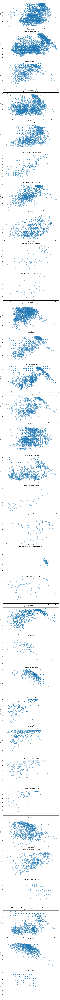

In [17]:
regions = df['region'].unique()

# Create subplots for each region
fig, axes = plt.subplots(nrows=len(regions), figsize=(12, 6 * len(regions)))

for i, region in enumerate(regions):
    region_data = df[df['region'] == region]
    
    # Create scatter plot for temperature against humidity for each region
    axes[i].scatter(region_data['temperature_celsius'], region_data['humidity'], alpha=0.5)
    
    axes[i].set_title(f'Temperature vs. Humidity - {region}')
    axes[i].set_xlabel('Temperature (°C)')
    axes[i].set_ylabel('Humidity (%)')

plt.tight_layout()
plt.show()


## 2. Wind
Analyzing the Wind Parameter by plotting several Visualizaions

### Average Wind Speed (kph) By Region

In [18]:
mean_wind_speed_by_region = df.groupby('region')['wind_kph'].mean().reset_index()
sorted_mean_wind_speed = mean_wind_speed_by_region.sort_values(by='wind_kph', ascending=False)

fig = px.bar(sorted_mean_wind_speed,
             x='region',
             y='wind_kph',
             title='Average Wind Speed (kph) by Region',
             labels={'wind_kph': 'Wind Speed (kph)', 'region': 'Region'})

fig.update_layout(xaxis=dict(tickangle=45))
fig.show()


The Coastal Proximate regions of **Andaman and Nicobar Islands**, **Puducherry**, **Lakshadweep**, **Gujarat** and **Daman and Diu** exhibit higher average wind speeds, while some north-east regions of **Manipur**, **Mizoram**, **Tripura**, **Nagaland**, and **Assam** experience comparatively lower average wind speeds.

In [19]:
# Create a map centered around the first location in the DataFrame
map_center = [df['latitude'].iloc[0], df['longitude'].iloc[0]]
mymap = folium.Map(location=map_center, zoom_start=6)

# Iterate through unique regions
for region in unique_regions:
    region_data = df[df['region'] == region]
    
    # Calculate average latitude and longitude for the region
    avg_latitude = region_data['latitude'].mean()
    avg_longitude = region_data['longitude'].mean()
    
    # Get min and max temperatures for the region
    min_wind = region_data['wind_kph'].min()
    max_wind = region_data['wind_kph'].max()
    
    # Create a popup with region and temperature information
    popup_text = f"Region: {region}<br>Min Wind: {min_wind} kph <br>Max wind: {max_wind} kph"
    
    # Customize the marker icon and text
    marker_icon = folium.Icon(color='blue', icon='info-sign')
    marker = folium.Marker(location=[avg_latitude, avg_longitude], icon=marker_icon,tooltip=f"{region} Wind Speed - Min: {min_wind} kph, Max: {max_wind} kph")
    
    # Customize the font style and color of the text inside the marker
    marker.add_child(folium.Popup(popup_text, parse_html=False, max_width=300))
    marker.add_to(mymap)

# Display the map directly in the output cell
mymap
